# Installing Wrappers

In [195]:
# !pip install scikeras
# !pip install keras-tuner

# Importing Libraries

In [161]:
import os
import cv2
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
import matplotlib.pyplot as plt
import random
import shutil
from tensorflow.keras.utils import to_categorical
from keras.optimizers import Adam
import tensorflow.keras.backend as K
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.preprocessing.image import ImageDataGenerator
from keras.models import load_model
from kerastuner import HyperModel
from kerastuner.tuners import RandomSearch

# Data Processing

In [163]:
# Paths to the dataset folders
Fifa_Players = 'Fifa_Players'

In [164]:
# Check if the path exists and is a directory
if os.path.isdir(Fifa_Players):
    # Iterate over each item in the directory
    for player_name in os.listdir(Fifa_Players):
        player_path = os.path.join(Fifa_Players, player_name)
        if os.path.isdir(player_path):
            print(f"Player: {player_name}")
            # Get a list of files in the player's directory
            image_files = os.listdir(player_path)
            # Print the first 5 image names to avoid flooding the output
            for image_file in image_files[:5]:
                print(f"  - {image_file}")
            print("...")
else:
    print(f"The path '{Fifa_Players}' does not exist or is not a directory.")

Player: Bruno Fernandes
  - image_20211118_170131.jpg
  - image_20211118_170131_782.jpg
  - image_20211118_170131_783.jpg
  - image_20211118_170131_784.jpg
  - image_20211118_170131_785.jpg
...
Player: Cesar Azpilicueta
  - image_20211118_170100.jpg
  - image_20211118_170100_69.jpg
  - image_20211118_170100_71.jpg
  - image_20211118_170101.jpg
  - image_20211118_170101_77.jpg
...
Player: Cristiano Ronaldo
  - image_20211118_170123.jpg
  - image_20211118_170123_601.jpg
  - image_20211118_170123_604.jpg
  - image_20211118_170123_605.jpg
  - image_20211118_170123_608.jpg
...
Player: Erling Haaland
  - image_20211118_170118.jpg
  - image_20211118_170118_475.jpg
  - image_20211118_170118_476.jpg
  - image_20211118_170118_477.jpg
  - image_20211118_170118_478.jpg
...
Player: Gerard Moreno
  - image_20211118_170128.jpg
  - image_20211118_170128.png
  - image_20211118_170128_694.jpg
  - image_20211118_170128_695.jpg
  - image_20211118_170128_697.jpg
...
Player: Gianluigi Donnarumma
  - image_2

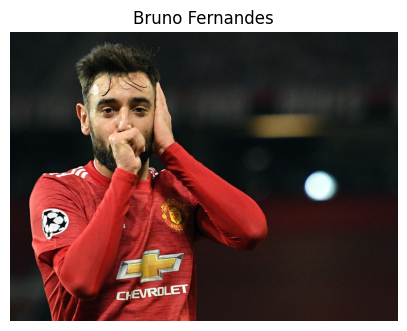

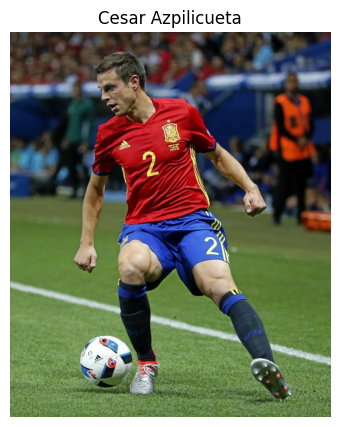

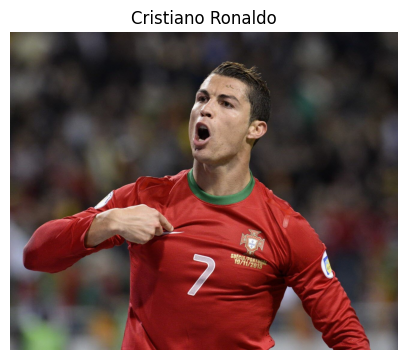

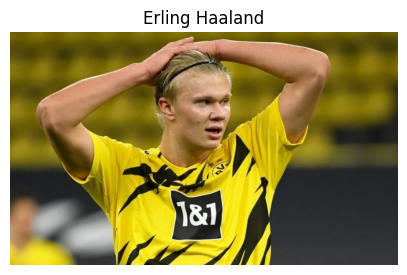

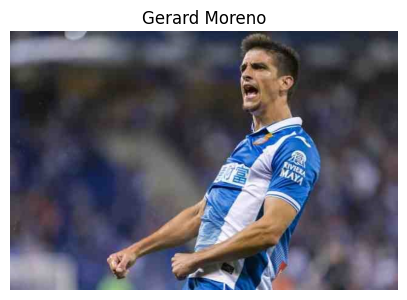

...

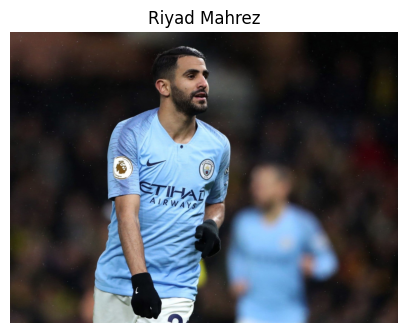

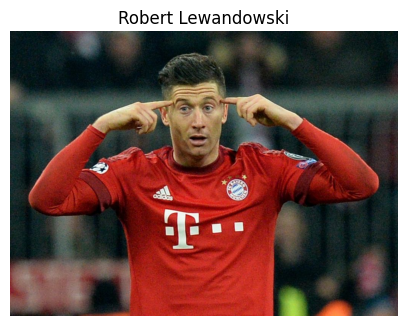

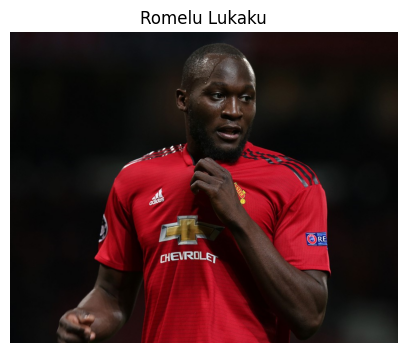

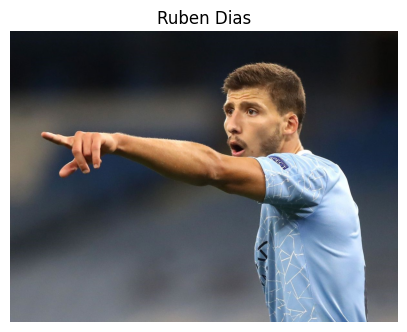

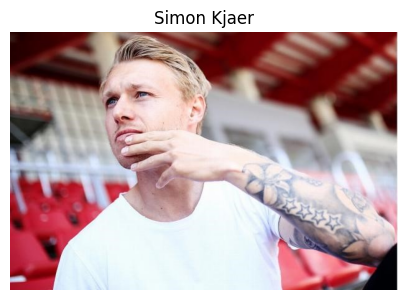

In [165]:
def display_random_image_from_each_player(folder_path):
    if os.path.isdir(folder_path):
        for player_name in os.listdir(folder_path):
            player_path = os.path.join(folder_path, player_name)
            if os.path.isdir(player_path):
                image_files = os.listdir(player_path)
                if image_files:
                    random_image_name = random.choice(image_files)
                    random_image_path = os.path.join(player_path, random_image_name)
                    image = cv2.imread(random_image_path)
                    if image is not None:  # Check if the image was loaded successfully
                        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB
                        plt.figure(figsize=(5, 5))
                        plt.imshow(image)
                        plt.title(player_name)
                        plt.axis('off')
                        plt.show()
                    else:
                        print(f"Failed to load image: {random_image_path}")
                else:
                    print(f"No images found in {player_path}")
    else:
        print(f"The path '{folder_path}' does not exist or is not a directory.")

display_random_image_from_each_player(Fifa_Players)

In [166]:
# Specify the path to the corrupt image file using the variable delete_path
delete_path = 'Fifa_Players/N+ó_TGolo Kante/image_20211118_170145_1142.jpg'

# Check if the file exists before attempting to delete it
if os.path.exists(delete_path):
    os.remove(delete_path)
    print(f"Removed corrupt image: {delete_path}")
else:
    print(f"The file does not exist: {delete_path}")

The file does not exist: Fifa_Players/N+ó_TGolo Kante/image_20211118_170145_1142.jpg


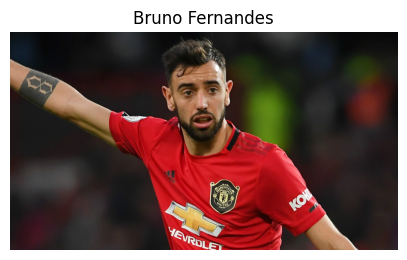

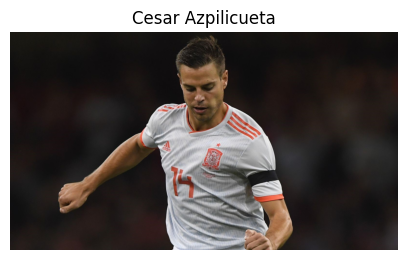

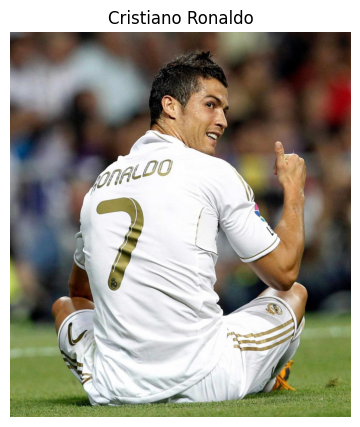

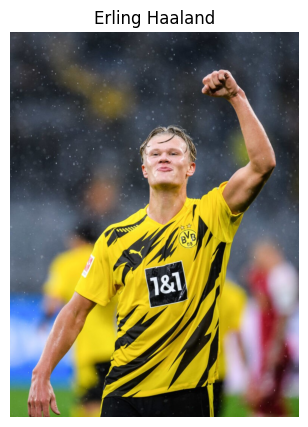

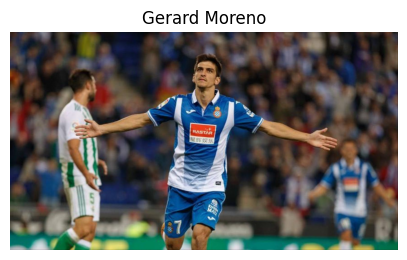

...

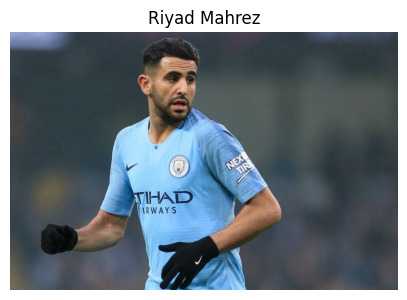

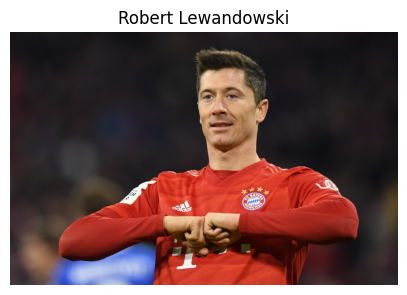

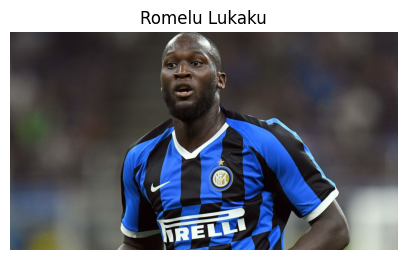

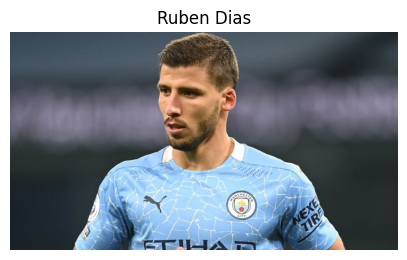

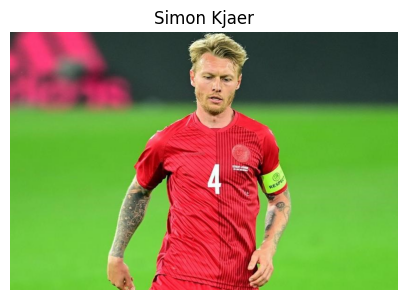

In [167]:
display_random_image_from_each_player(Fifa_Players)

In [168]:
import shutil

# Specify the path to the player's directory you want to delete
player_directory_path = 'Fifa_Players/N+ó_TGolo Kante'

# Check if the directory exists before attempting to delete it
if os.path.exists(player_directory_path) and os.path.isdir(player_directory_path):
    shutil.rmtree(player_directory_path)
    print(f"Removed directory and all its contents: {player_directory_path}")
else:
    print(f"The directory does not exist: {player_directory_path}")

The directory does not exist: Fifa_Players/N+ó_TGolo Kante


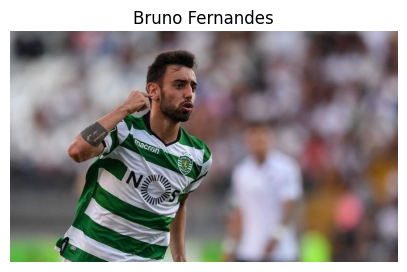

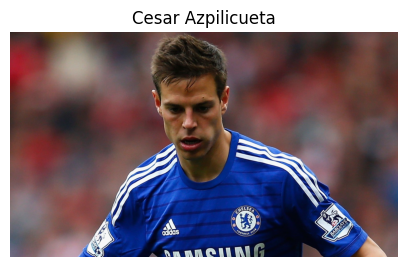

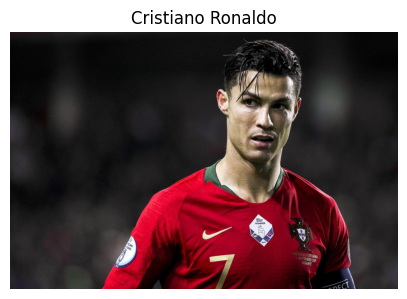

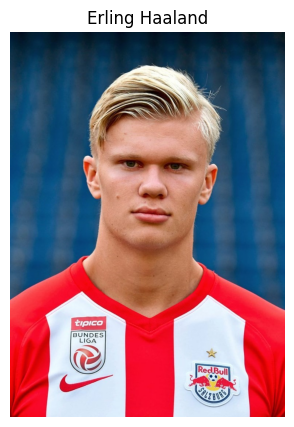

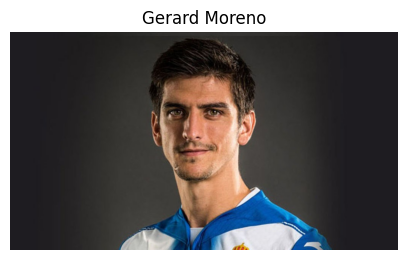

...

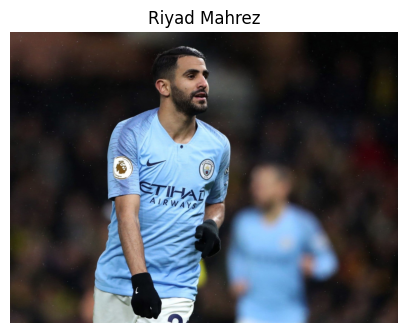

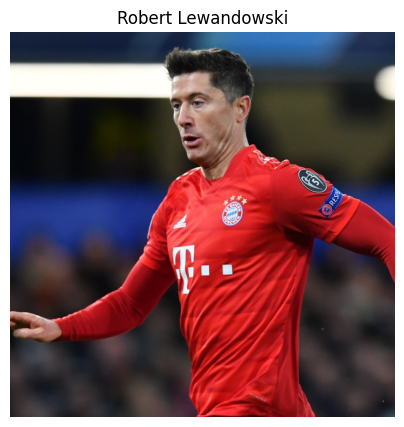

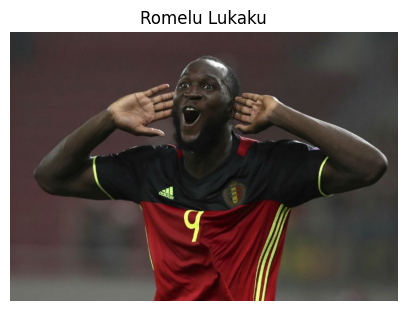

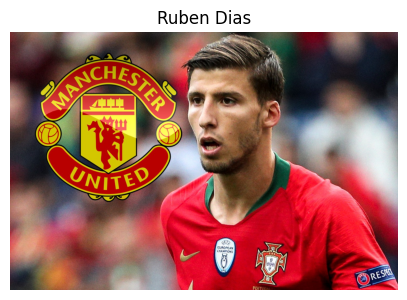

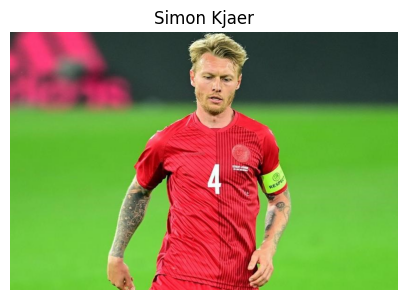

In [169]:
display_random_image_from_each_player(Fifa_Players)

# Loading Labels and Images For All Players

In [170]:
import os
import cv2
import numpy as np
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical

def load_images_and_labels_for_all_players(image_folder):
    labels = []
    images = []

    # Load images and labels for all players
    for class_name in os.listdir(image_folder):
        class_path = os.path.join(image_folder, class_name)
        if os.path.isdir(class_path):
            for image_name in os.listdir(class_path):
                image_path = os.path.join(class_path, image_name)
                image = cv2.imread(image_path)
                if image is None:
                    print(f"Warning: Could not load image at {image_path}")
                    continue
                
                # Check if the loaded image is empty (None)
                if image.size == 0:
                    print(f"Warning: Empty image at {image_path}")
                    continue

                image = cv2.resize(image, (150, 150))
                images.append(image)
                labels.append(class_name)

    images = np.array(images)
    labels = np.array(labels)

    # Normalize image data
    images = images / 255.0

    # Encode labels
    label_encoder = LabelEncoder()
    encoded_labels = label_encoder.fit_transform(labels)
    encoded_labels = to_categorical(encoded_labels)

    return images, encoded_labels, label_encoder

In [171]:
# Load images and labels for all players
images_all_players, encoded_labels_all_players, label_encoder_all_players = load_images_and_labels_for_all_players(Fifa_Players)

# Split dataset
X_train_all_players, X_test_all_players, y_train_all_players, y_test_all_players = train_test_split(images_all_players, encoded_labels_all_players, test_size=0.2, random_state=42)


# Creating a Multiclass Model

In [172]:
from keras.optimizers import Adam
# Define custom learning rate
custom_learning_rate_all_players = 0.001

# Create an instance of the Adam optimizer with the custom learning rate
optimizer_all_players = Adam(learning_rate=custom_learning_rate_all_players)

# Clear the Keras session before compiling the model
import tensorflow.keras.backend as K
K.clear_session()

model_all_players = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(29, activation='softmax')  # Adjusted for multi-class classification
])

# Now, use the optimizer instance with the custom learning rate
model_all_players.compile(optimizer=optimizer_all_players, loss='categorical_crossentropy', metrics=['accuracy'])

In [173]:
from keras.callbacks import EarlyStopping, ModelCheckpoint

# EarlyStopping callback for all players
early_stopping_all_players = EarlyStopping(monitor='val_loss', patience=5, verbose=1, mode='min')

# ModelCheckpoint callback for all players
model_checkpoint_all_players = ModelCheckpoint(
    'best_AllPlayers.h5', monitor='val_loss', save_best_only=True, verbose=1, mode='min'
)

callbacks_all = [early_stopping_all_players, model_checkpoint_all_players]

In [174]:
from keras.preprocessing.image import ImageDataGenerator

# Create an instance of ImageDataGenerator with desired augmentations for all players
data_generator_all_players = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Training Model with Checkpoints and Observing Accuracy

In [175]:
# Now you can train the model
history_all_players = model_all_players.fit(
    data_generator_all_players.flow(X_train_all_players, y_train_all_players, batch_size=32),
    steps_per_epoch=len(X_train_all_players) // 32,
    epochs=10,
    validation_data=(X_test_all_players, y_test_all_players),
    callbacks=[early_stopping_all_players, model_checkpoint_all_players]
)

Epoch 1/10
33/33 [==============================] - ETA: 0s - loss: 5.8677 - accuracy: 0.0357
Epoch 1: val_loss improved from inf to 3.36572, saving model to best_AllPlayers.h5


C:\Users\shane\anaconda3\envs\Pytorch\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


33/33 [==============================] - 35s 971ms/step - loss: 5.8677 - accuracy: 0.0357 - val_loss: 3.3657 - val_accuracy: 0.0373
Epoch 2/10
33/33 [==============================] - ETA: 0s - loss: 3.3693 - accuracy: 0.0425
Epoch 2: val_loss did not improve from 3.36572
33/33 [==============================] - 40s 1s/step - loss: 3.3693 - accuracy: 0.0425 - val_loss: 3.3677 - val_accuracy: 0.0261
Epoch 3/10
33/33 [==============================] - ETA: 0s - loss: 3.3455 - accuracy: 0.0405
Epoch 3: val_loss did not improve from 3.36572
33/33 [==============================] - 31s 916ms/step - loss: 3.3455 - accuracy: 0.0405 - val_loss: 3.3666 - val_accuracy: 0.0187
Epoch 4/10
33/33 [==============================] - ETA: 0s - loss: 3.3204 - accuracy: 0.0618
Epoch 4: val_loss improved from 3.36572 to 3.35660, saving model to best_AllPlayers.h5
33/33 [==============================] - 31s 930ms/step - loss: 3.3204 - accuracy: 0.0618 - val_loss: 3.3566 - val_accuracy: 0.0224
Epoch 5/10
3

In [176]:
from keras.models import load_model
# Load the best model
model = load_model('best_AllPlayers.h5')

# Evaluate on the test set
loss, accuracy = model_all_players.evaluate(X_test_all_players, y_test_all_players)
print("Test Accuracy:", accuracy)

9/9 [==============================] - 2s 218ms/step - loss: 6.6174 - accuracy: 0.0261
Test Accuracy: 0.026119403541088104


# Displaying Predicitions to Visually see accuracy

9/9 [==============================] - 1s 148ms/step


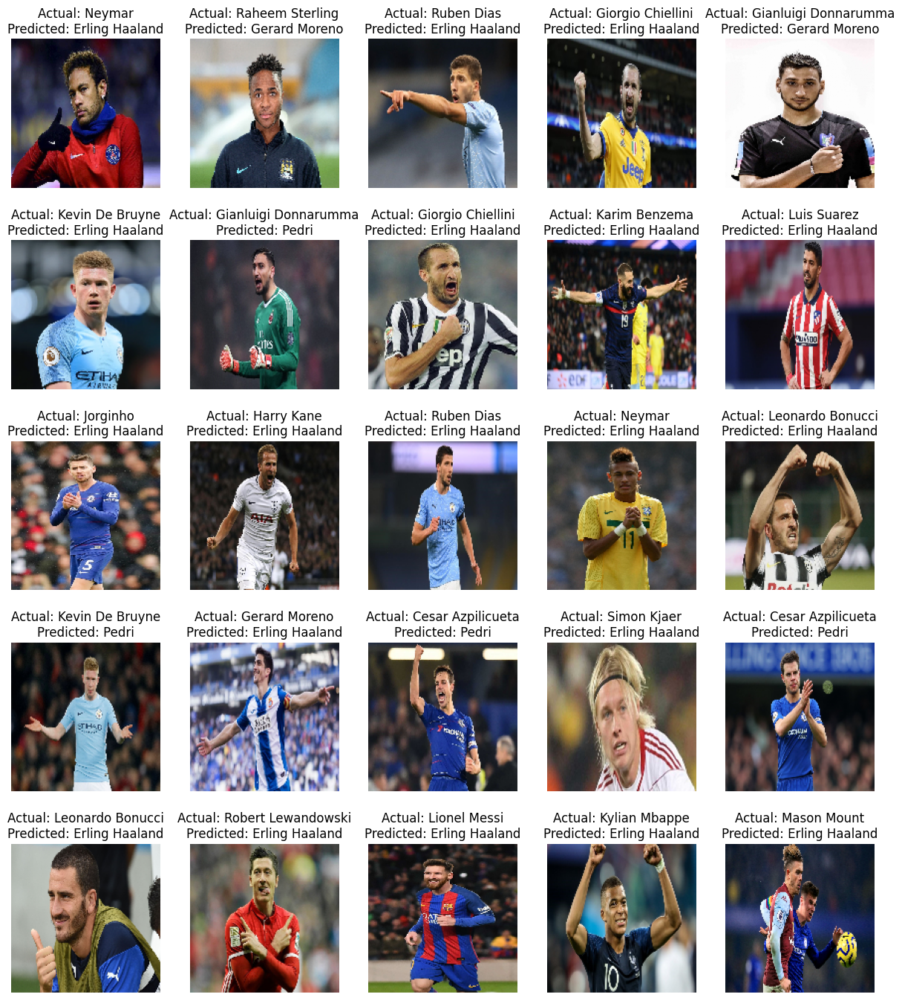

In [189]:
def display_predictions(images, actual_classes, predicted_classes, label_encoder):
    plt.figure(figsize=(15, 17))
    for i in range(len(images)):
        plt.subplot(5, 5, i+1)
        # Convert the image from BGR to RGB
        img_rgb = images[i][..., ::-1]
        plt.imshow(img_rgb)
        # Map class indices back to original labels (player names)
        actual_label = label_encoder.inverse_transform([actual_classes[i]])[0]
        predicted_label = label_encoder.inverse_transform([predicted_classes[i]])[0]
        plt.title(f"Actual: {actual_label}\nPredicted: {predicted_label}")
        plt.axis('off')
    plt.show()

# Generate predictions
predicted_classes = model_all_players.predict(X_test_all_players)
predicted_classes = np.argmax(predicted_classes, axis=1)
actual_classes = np.argmax(y_test_all_players, axis=1)

# Display a few predictions, ensuring label_encoder_all_players is passed correctly
display_predictions(X_test_all_players[:25], actual_classes[:25], predicted_classes[:25], label_encoder_all_players)

# Hyperparmeter Tuning for All Players

In [181]:
# Define a HyperModel for the "all players" dataset
class MyHyperModel_AllPlayers(HyperModel):
    def __init__(self, input_shape, num_classes):
        self.input_shape = input_shape
        self.num_classes = num_classes
    
    def build(self, hp):
        model = Sequential([
            Conv2D(filters=32, kernel_size=(3, 3), activation='relu', input_shape=self.input_shape),
            BatchNormalization(),
            MaxPooling2D(2, 2),
            Conv2D(64, (3, 3), activation='relu'),
            BatchNormalization(),
            MaxPooling2D(2, 2),
            Conv2D(128, (3, 3), activation='relu'),
            BatchNormalization(),
            MaxPooling2D(2, 2),
            Flatten(),
            Dense(units=hp.Int('units', min_value=256, max_value=1024, step=256), activation='relu'),
            Dropout(0.5),
            Dense(self.num_classes, activation='softmax')
        ])
        
        model.compile(optimizer=Adam(learning_rate=hp.Float('learning_rate', min_value=1e-4, max_value=1e-2, sampling='LOG')),
                      loss='categorical_crossentropy',
                      metrics=['accuracy'])
        
        return model

In [182]:
# Create a HyperModel for the "all players" dataset
hypermodel_all_players = MyHyperModel_AllPlayers(input_shape=(150, 150, 3), num_classes=len(label_encoder_all_players.classes_))

# Use RandomSearch or other tuner of your choice
tuner_all_players = RandomSearch(
    hypermodel_all_players,
    objective='val_accuracy',
    max_trials=10,  # Set this to a reasonable number to limit the search time
    executions_per_trial=1,
    directory='my_dir_all_players',
    project_name='all_players'
)

# Perform hyperparameter search for the "all players" dataset
tuner_all_players.search(data_generator_all_players.flow(X_train_all_players, y_train_all_players, batch_size=32),
                         validation_data=(X_test_all_players, y_test_all_players),
                         epochs=10,
                         callbacks=[early_stopping_all_players])

Trial 10 Complete [00h 03m 55s]
val_accuracy: 0.05597015097737312

Best val_accuracy So Far: 0.0746268630027771
Total elapsed time: 00h 46m 51s


In [191]:
# Get the best model
best_model_all_players = tuner_all_players.get_best_models(num_models=1)[0]
best_hyperparameters_all_players = tuner_all_players.get_best_hyperparameters()[0]

# Evaluate the best model for the "all players" dataset
loss_all_players, accuracy_all_players = best_model_all_players.evaluate(X_test_all_players, y_test_all_players)
print(f"Best model accuracy for all players: {accuracy_all_players}")

9/9 [==============================] - 2s 136ms/step - loss: 3.3565 - accuracy: 0.0746
Best model accuracy for all players: 0.0746268630027771


9/9 [==============================] - 1s 155ms/step


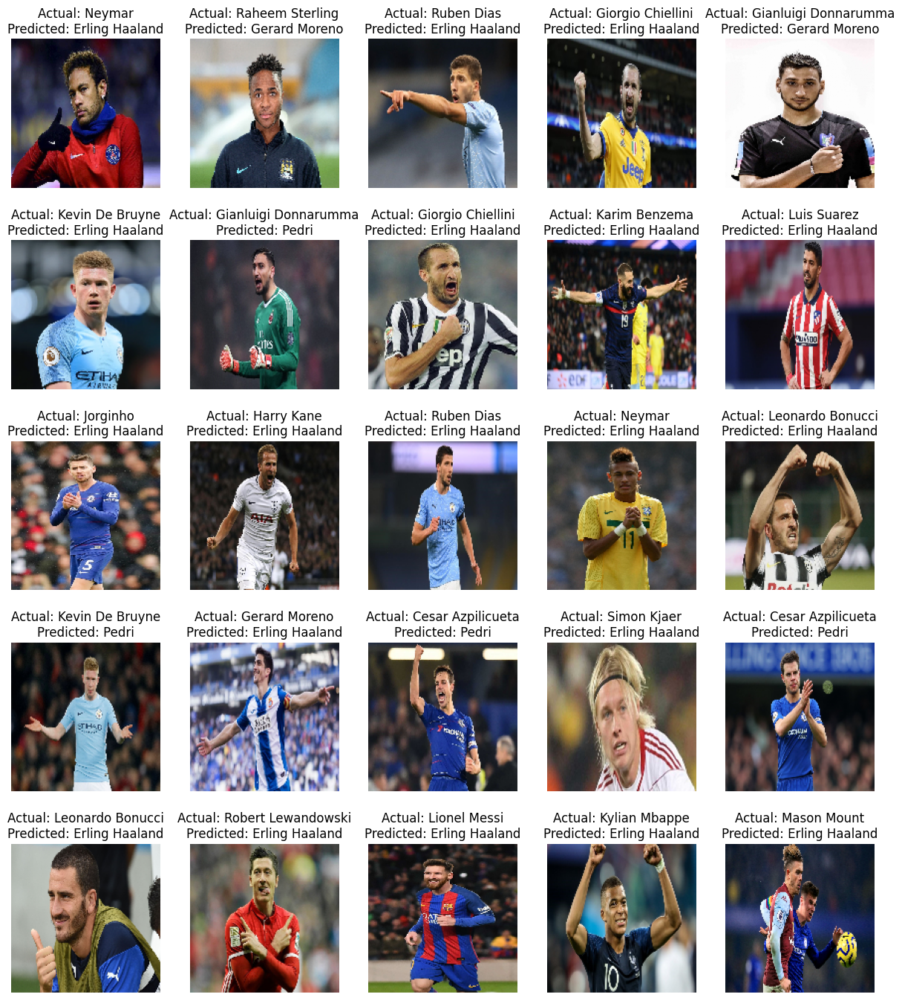

In [193]:
# Generate predictions
predicted_classes = model_all_players.predict(X_test_all_players)
predicted_classes = np.argmax(predicted_classes, axis=1)
actual_classes = np.argmax(y_test_all_players, axis=1)

# Display a few predictions, ensuring label_encoder_all_players is passed correctly
display_predictions(X_test_all_players[:25], actual_classes[:25], predicted_classes[:25], label_encoder_all_players)

9/9 [==============================] - 2s 177ms/step


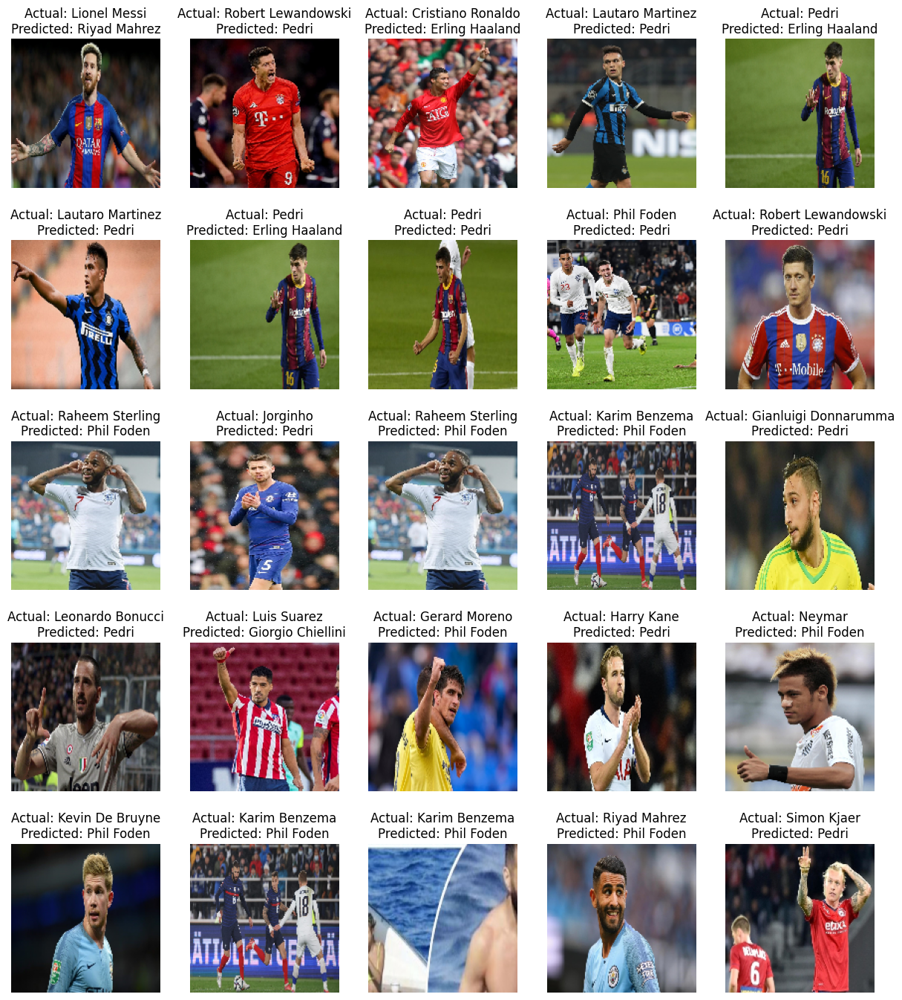

In [194]:
def display_random_predictions(images, actual_classes, predicted_classes, label_encoder):
    plt.figure(figsize=(15, 17))
    num_samples = len(images)
    
    # Calculate the maximum number of subplots
    max_subplots = min(num_samples, 25)
    
    for i in range(max_subplots):
        plt.subplot(5, 5, i+1)
        
        # Choose a random index for each player
        random_index = random.randint(0, num_samples - 1)
        
        # Get the random image and its corresponding labels
        random_image = images[random_index]
        actual_label = label_encoder.inverse_transform([actual_classes[random_index]])[0]
        predicted_label = label_encoder.inverse_transform([predicted_classes[random_index]])[0]
        
        # Convert the random image from BGR to RGB
        img_rgb = random_image[..., ::-1]
        plt.imshow(img_rgb)
        
        # Display labels
        plt.title(f"Actual: {actual_label}\nPredicted: {predicted_label}")
        plt.axis('off')
    
    plt.show()

# Generate predictions for all players dataset
predicted_classes_all_players = best_model_all_players.predict(X_test_all_players)
predicted_classes_all_players = np.argmax(predicted_classes_all_players, axis=1)
actual_classes_all_players = np.argmax(y_test_all_players, axis=1)

# Display random predictions for all players
display_random_predictions(X_test_all_players, actual_classes_all_players, predicted_classes_all_players, label_encoder_all_players)

In [7]:
Observation = print('With Hyperparmeter tuning we see that accuracy has increased by 4-5%')
Observation 

With Hyperparmeter tuning we see that accuracy has increased by 4-5%


# Extracting Data for Binary Classification

In [93]:
Cristiano_Ronaldo = 'Fifa_Players/Cristiano Ronaldo'
Lionel_Messi = 'Fifa_Players/Lionel Messi'

# Loading Data For Specfic Case

In [94]:
def load_images_and_labels_for_two_players(image_folder, player_names):
    labels = []
    images = []
    label_encoder = LabelEncoder()

    for player_name in player_names:
        class_path = os.path.join(image_folder, player_name)
        if os.path.isdir(class_path):
            for image_name in os.listdir(class_path):
                image_path = os.path.join(class_path, image_name)
                image = cv2.imread(image_path)
                if image is None:
                    print(f"Warning: Could not load image at {image_path}")
                    continue
                image = cv2.resize(image, (150, 150))
                images.append(image)
                labels.append(player_name)

    images = np.array(images)
    labels = np.array(labels)

    # Normalize image data
    images = images / 255.0

    # Encode labels
    labels = label_encoder.fit_transform(labels)
    encoded_labels = to_categorical(labels)

    return images, encoded_labels, label_encoder

# Specify the names of the two players
player_names = ['Lionel Messi', 'Cristiano Ronaldo']
images, encoded_labels, label_encoder = load_images_and_labels_for_two_players('Fifa_Players', player_names)

In [95]:
# Split dataset
X_train, X_test, y_train, y_test = train_test_split(images, encoded_labels, test_size=0.2, random_state=42)

# Creating Model For Binary Classification

In [101]:
# Define custom learning rate
custom_learning_rate = 0.001

# Create an instance of the Adam optimizer with the custom learning rate
optimizer = Adam(learning_rate=custom_learning_rate)

model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(2, activation='softmax')  # Use 2 units for one-hot encoded binary classification
])

model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

In [102]:
from keras.callbacks import EarlyStopping, ModelCheckpoint

# EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, verbose=1, mode='min')

# ModelCheckpoint callback
model_checkpoint = ModelCheckpoint(
    'MessivsRonaldo.h5', monitor='val_loss', save_best_only=True, verbose=1, mode='min'
)

callbacks = [early_stopping, model_checkpoint]

# Training Model, Checking Accuracy and Predictions

In [103]:
from keras.preprocessing.image import ImageDataGenerator

# Create an instance of ImageDataGenerator with desired augmentations
data_generator = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

In [104]:
# Compute the number of training samples for the `steps_per_epoch` parameter
steps_per_epoch = X_train.shape[0] // 32

history = model.fit(
    data_generator.flow(X_train, y_train, batch_size=32),
    steps_per_epoch=steps_per_epoch,
    epochs=10,
    validation_data=(X_test, y_test),
    callbacks=callbacks  # Add callbacks here
)

Epoch 1/10
2/2 [==============================] - ETA: 0s - loss: 2.8799 - accuracy: 0.4444
Epoch 1: val_loss improved from inf to 1.13126, saving model to MessivsRonaldo.h5


C:\Users\shane\anaconda3\envs\Pytorch\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


2/2 [==============================] - 4s 969ms/step - loss: 2.8799 - accuracy: 0.4444 - val_loss: 1.1313 - val_accuracy: 0.6000
Epoch 2/10
2/2 [==============================] - ETA: 0s - loss: 7.9849 - accuracy: 0.5778 
Epoch 2: val_loss improved from 1.13126 to 0.86584, saving model to MessivsRonaldo.h5
2/2 [==============================] - 2s 805ms/step - loss: 7.9849 - accuracy: 0.5778 - val_loss: 0.8658 - val_accuracy: 0.4000
Epoch 3/10
2/2 [==============================] - ETA: 0s - loss: 3.4496 - accuracy: 0.6562
Epoch 3: val_loss did not improve from 0.86584
2/2 [==============================] - 2s 822ms/step - loss: 3.4496 - accuracy: 0.6562 - val_loss: 1.6354 - val_accuracy: 0.4000
Epoch 4/10
2/2 [==============================] - ETA: 0s - loss: 5.6590 - accuracy: 0.6250
Epoch 4: val_loss did not improve from 0.86584
2/2 [==============================] - 2s 1s/step - loss: 5.6590 - accuracy: 0.6250 - val_loss: 2.0048 - val_accuracy: 0.4000
Epoch 5/10
2/2 [==============

In [105]:
from keras.models import load_model
# Load the best model
model = load_model('MessivsRonaldo.h5')

# Evaluate on the test set
loss, accuracy = model.evaluate(X_test, y_test)
print("Test Accuracy:", accuracy)

1/1 [==============================] - 0s 472ms/step - loss: 0.8658 - accuracy: 0.4000
Test Accuracy: 0.4000000059604645


1/1 [==============================] - 0s 374ms/step


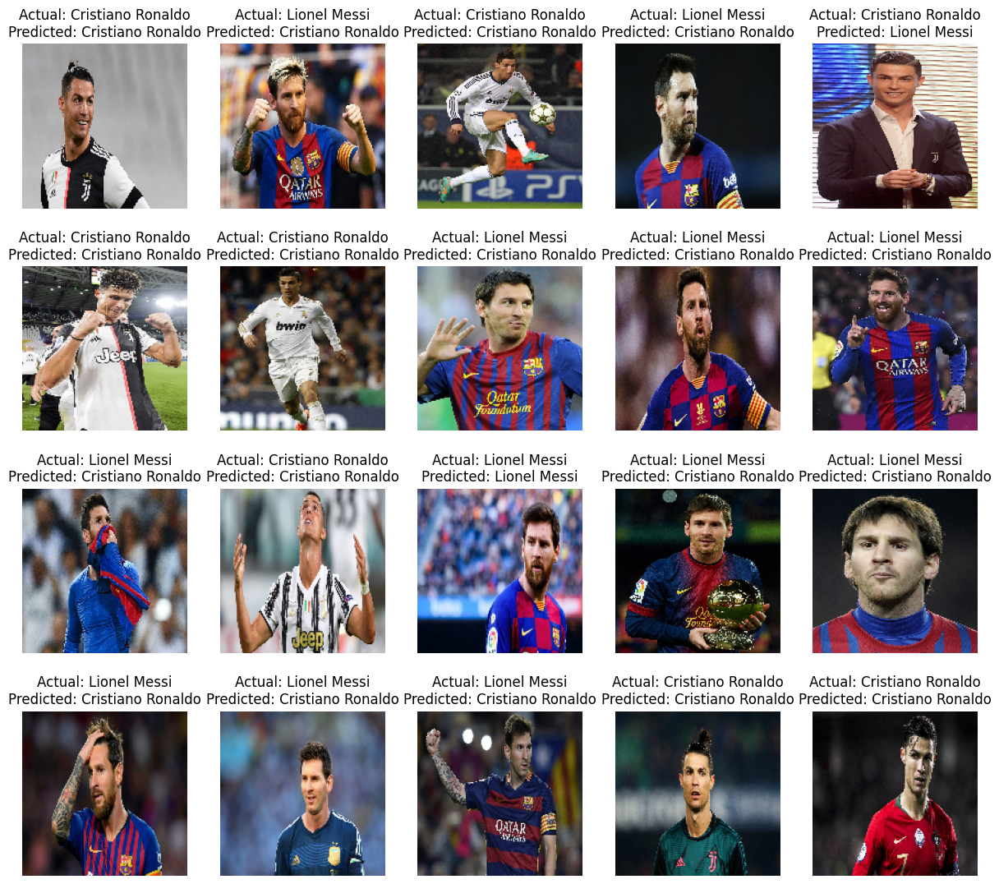

In [106]:
def display_predictions(images, actual_classes, predicted_classes, label_encoder):
    plt.figure(figsize=(15, 17))
    for i in range(len(images)):
        plt.subplot(5, 5, i+1)
        # Convert the image from BGR to RGB
        img_rgb = images[i][..., ::-1]
        plt.imshow(img_rgb)
        # Map class indices back to original labels (player names)
        actual_label = label_encoder.inverse_transform([actual_classes[i]])[0]
        predicted_label = label_encoder.inverse_transform([predicted_classes[i]])[0]
        plt.title(f"Actual: {actual_label}\nPredicted: {predicted_label}")
        plt.axis('off')
    plt.show()

# Generate predictions
predicted_classes = model.predict(X_test)
predicted_classes = np.argmax(predicted_classes, axis=1)
actual_classes = np.argmax(y_test, axis=1)

# Display a few predictions, ensuring label_encoder is passed correctly
display_predictions(X_test[:25], actual_classes[:25], predicted_classes[:25], label_encoder)

# Hypertuning Binary Classification

In [108]:
from kerastuner import HyperModel

class MyHyperModel(HyperModel):
    def __init__(self, input_shape):
        self.input_shape = input_shape
    
    def build(self, hp):
        model = Sequential([
            Conv2D(filters=32, kernel_size=(3, 3), activation='relu', input_shape=self.input_shape),
            BatchNormalization(),
            MaxPooling2D(2, 2),
            Conv2D(64, (3, 3), activation='relu'),
            BatchNormalization(),
            MaxPooling2D(2, 2),
            Conv2D(128, (3, 3), activation='relu'),
            BatchNormalization(),
            MaxPooling2D(2, 2),
            Flatten(),
            Dense(units=hp.Int('units', min_value=256, max_value=1024, step=256), activation='relu'),
            Dropout(0.5),
            Dense(2, activation='softmax')
        ])
        
        model.compile(optimizer=Adam(learning_rate=hp.Float('learning_rate', min_value=1e-4, max_value=1e-2, sampling='LOG')),
                      loss='categorical_crossentropy',
                      metrics=['accuracy'])
        
        return model

C:\Users\shane\AppData\Local\Temp\ipykernel_457156\1842608493.py:1: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner import HyperModel


In [127]:
from kerastuner.tuners import RandomSearch

hypermodel = MyHyperModel(input_shape=(150, 150, 3))

tuner = RandomSearch(
    hypermodel,
    objective='val_accuracy',
    max_trials=10,  # Set this to a reasonable number to limit the search time
    executions_per_trial=1,
    directory='my_dir',
    project_name='messi_vs_ronaldo'
)

tuner.search(data_generator.flow(X_train, y_train, batch_size=32),
             validation_data=(X_test, y_test),
             epochs=10,
             callbacks=[early_stopping])

Reloading Tuner from my_dir\messi_vs_ronaldo\tuner0.json


In [128]:
best_model = tuner.get_best_models(num_models=1)[0]
best_hyperparameters = tuner.get_best_hyperparameters()[0]

# Evaluate the best model
loss, accuracy = best_model.evaluate(X_test, y_test)
print(f"Best model accuracy: {accuracy}")

1/1 [==============================] - 1s 1s/step - loss: 0.6125 - accuracy: 0.9000
Best model accuracy: 0.8999999761581421


In [9]:
Oberservation2 = print(' The accuracy of the model has increased by 50% using hypertuning')
Oberservation2

 The accuracy of the model has increased by 50% using hypertuning


# Prediciting Binary Classification From Data Set and From Outside Data Set to Test Real World Application

1/1 [==============================] - 1s 514ms/step


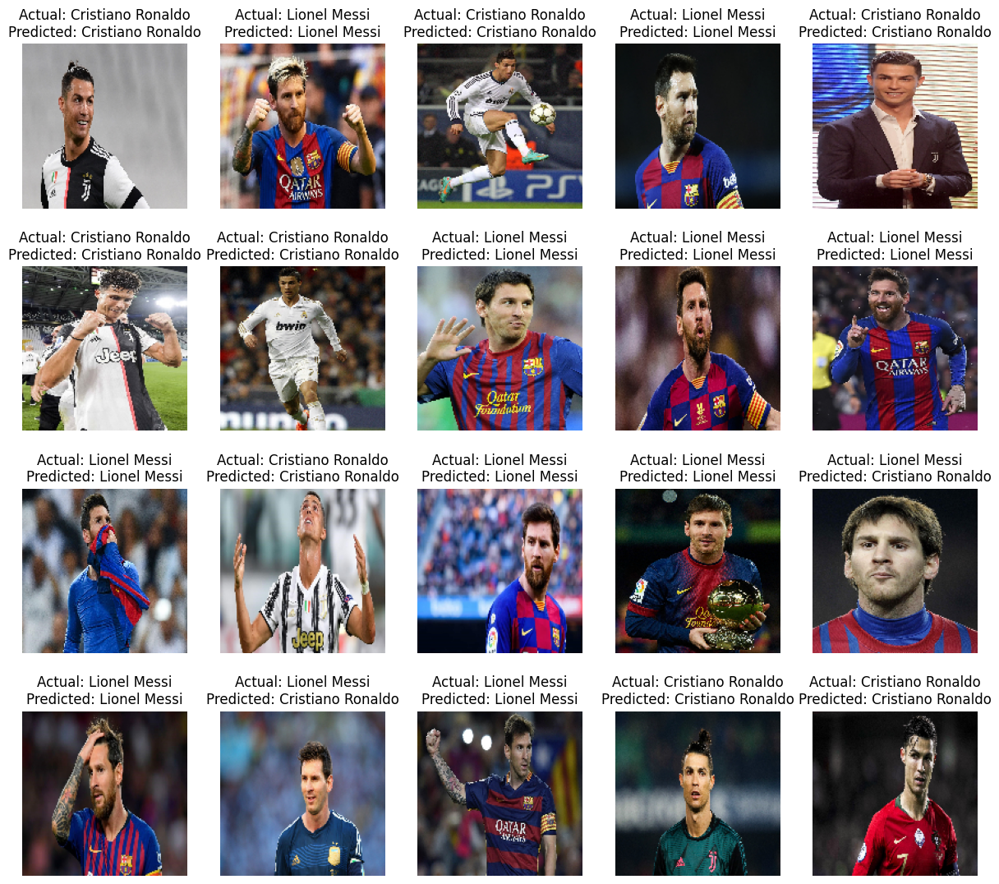

In [196]:
# Generate predictions
predicted_classes = best_model.predict(X_test)
predicted_classes = np.argmax(predicted_classes, axis=1)
actual_classes = np.argmax(y_test, axis=1)

# Display a few predictions, ensuring label_encoder is passed correctly
display_predictions(X_test[:25], actual_classes[:25], predicted_classes[:25], label_encoder)

1/1 [==============================] - 0s 124ms/step


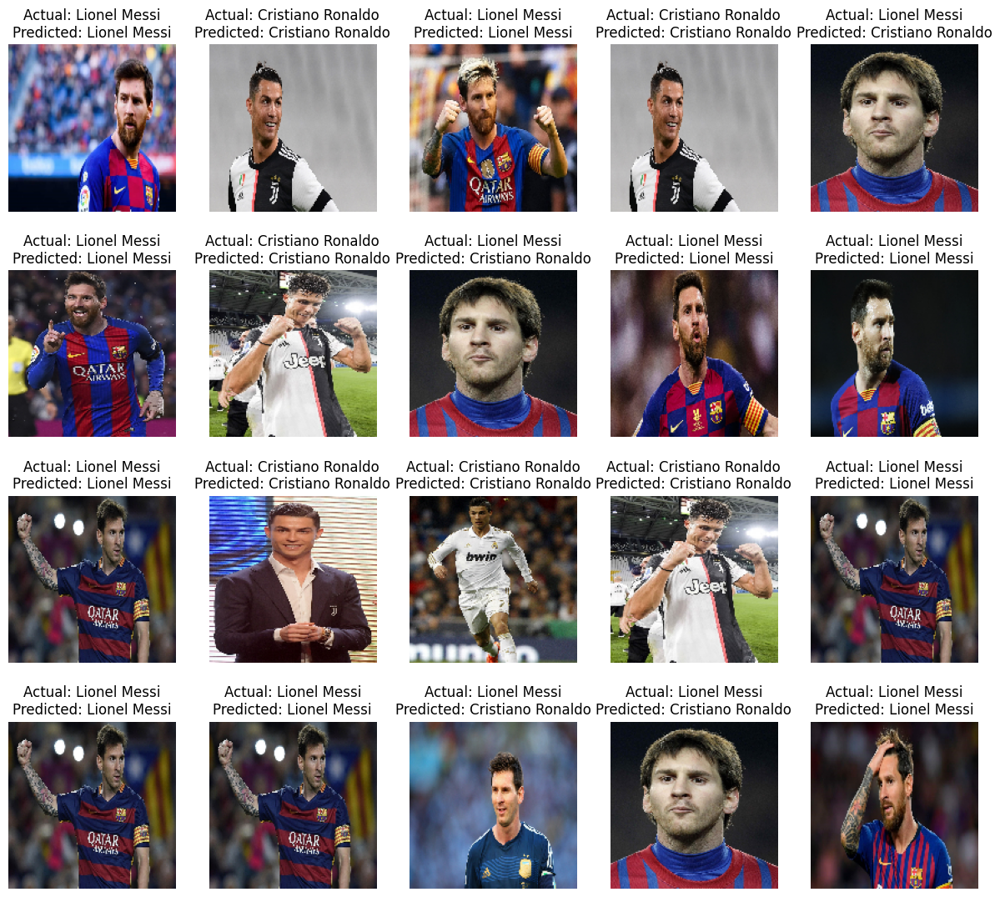

In [199]:
# Generate predictions
predicted_classes = best_model.predict(X_test)
predicted_classes = np.argmax(predicted_classes, axis=1)
actual_classes = np.argmax(y_test, axis=1)

# Display a few predictions, ensuring label_encoder is passed correctly
display_random_predictions(X_test[:25], actual_classes[:25], predicted_classes[:25], label_encoder)

In [212]:
test_images_folder = 'Messi_Vs_Ranaldo'

In [223]:
#Predicting Images Sourced from Google Searches
def predict_and_display_image(image_path, model, label_encoder):
    # Load and preprocess the image
    img = cv2.imread(image_path)
    img = cv2.resize(img, (150, 150))
    img = img.astype('float32') / 255
    img = np.expand_dims(img, axis=0)
    
    # Make the prediction
    predicted_classes = best_model.predict(img)
    predicted_classes = np.argmax(predicted_classes, axis=1)
    predicted_label = label_encoder.inverse_transform(predicted_classes)
    
    # Display the image and predicted player's name
    plt.imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))
    plt.title(f'Predicted Player: {predicted_label[0]}')
    plt.axis('off')
    plt.show()

1/1 [==============================] - 0s 36ms/step


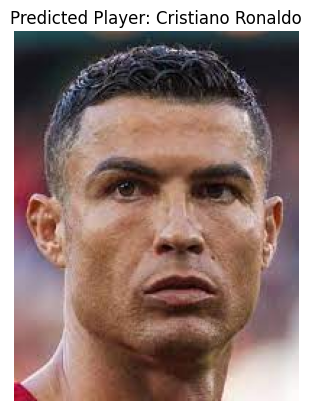

Image: download (1).jpg, Predicted Player: None
1/1 [==============================] - 0s 32ms/step


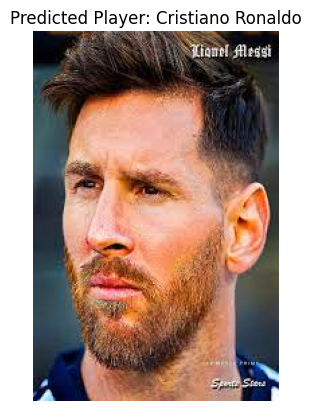

Image: download (10).jpg, Predicted Player: None
1/1 [==============================] - 0s 40ms/step


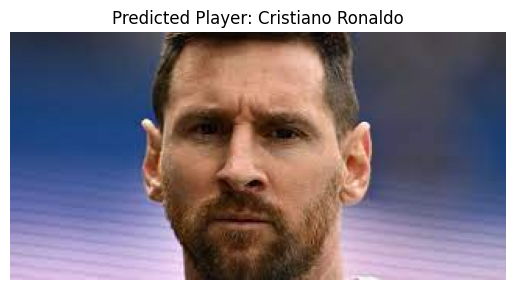

Image: download (11).jpg, Predicted Player: None
1/1 [==============================] - 0s 33ms/step


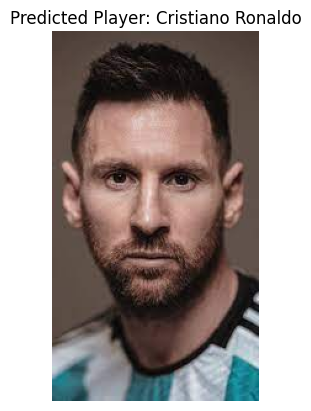

Image: download (12).jpg, Predicted Player: None
1/1 [==============================] - 0s 32ms/step


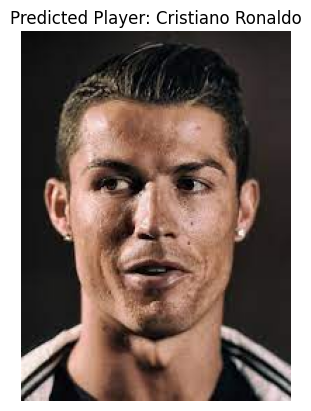

Image: download (13).jpg, Predicted Player: None
1/1 [==============================] - 0s 28ms/step


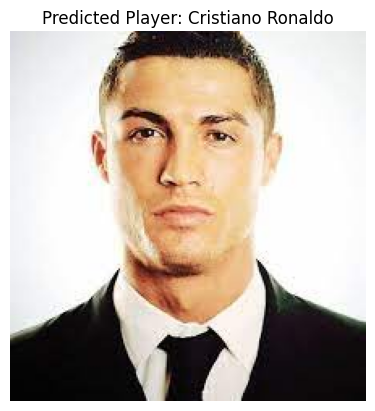

Image: download (14).jpg, Predicted Player: None
1/1 [==============================] - 0s 28ms/step


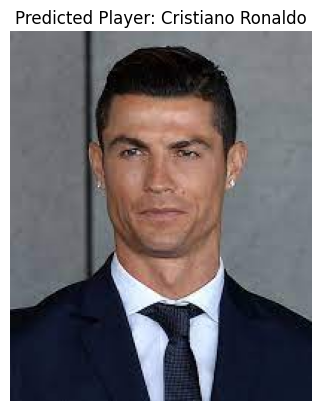

Image: download (2).jpg, Predicted Player: None
1/1 [==============================] - 0s 37ms/step


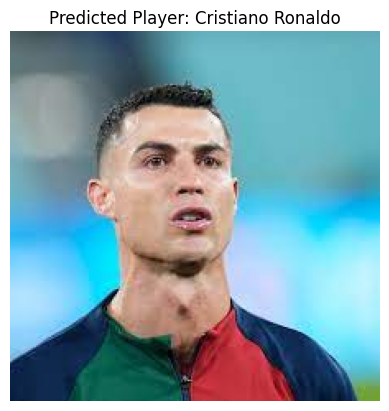

Image: download (3).jpg, Predicted Player: None
1/1 [==============================] - 0s 35ms/step


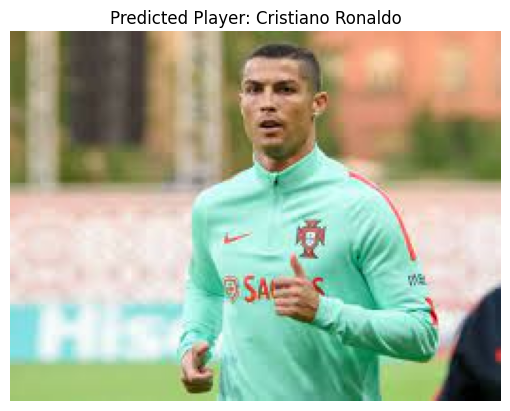

Image: download (4).jpg, Predicted Player: None
1/1 [==============================] - 0s 27ms/step


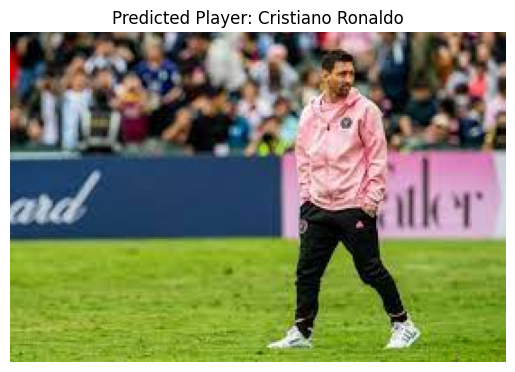

Image: download (5).jpg, Predicted Player: None
1/1 [==============================] - 0s 32ms/step


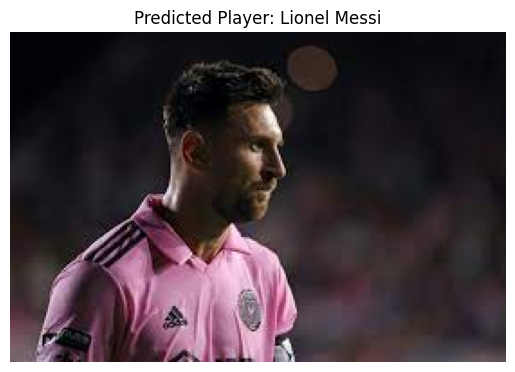

Image: download (6).jpg, Predicted Player: None
1/1 [==============================] - 0s 38ms/step


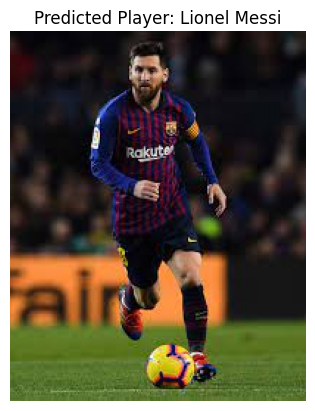

Image: download (7).jpg, Predicted Player: None
1/1 [==============================] - 0s 35ms/step


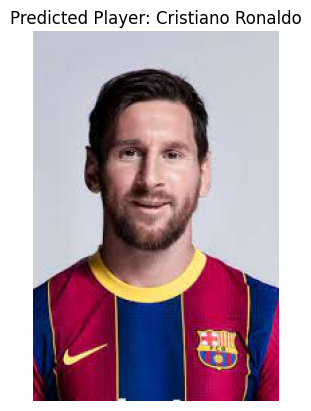

Image: download (8).jpg, Predicted Player: None
1/1 [==============================] - 0s 35ms/step


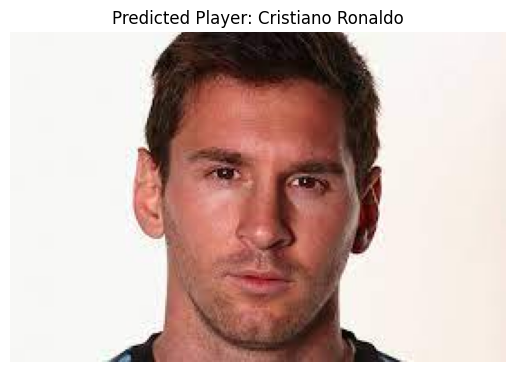

Image: download (9).jpg, Predicted Player: None
1/1 [==============================] - 0s 36ms/step


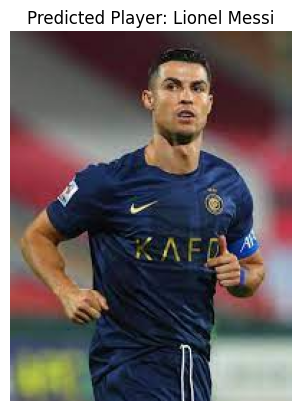

Image: download.jpg, Predicted Player: None
1/1 [==============================] - 0s 37ms/step


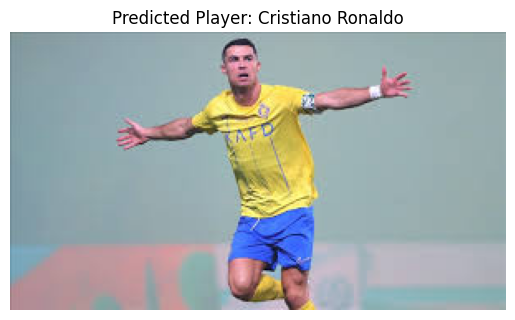

Image: images (1).jpg, Predicted Player: None
1/1 [==============================] - 0s 31ms/step


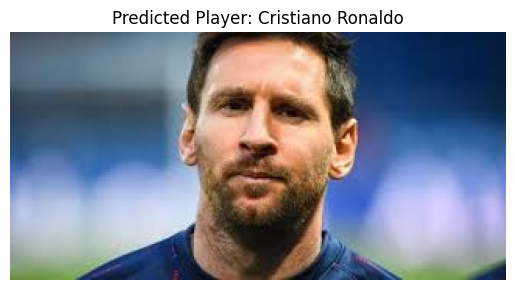

Image: images (10).jpg, Predicted Player: None
1/1 [==============================] - 0s 30ms/step


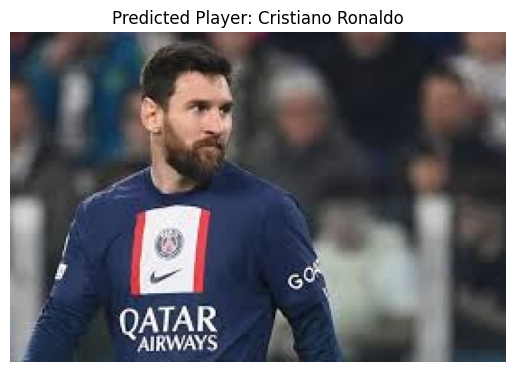

Image: images (11).jpg, Predicted Player: None
1/1 [==============================] - 0s 32ms/step


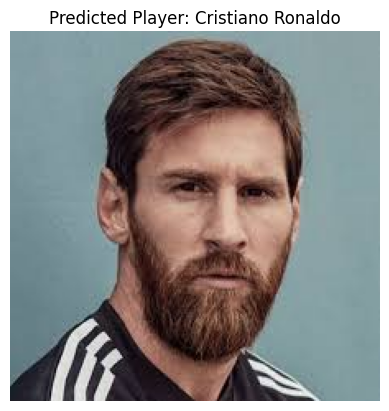

Image: images (12).jpg, Predicted Player: None
1/1 [==============================] - 0s 34ms/step


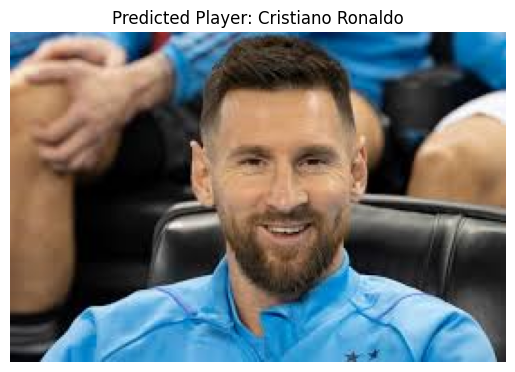

Image: images (13).jpg, Predicted Player: None
1/1 [==============================] - 0s 39ms/step


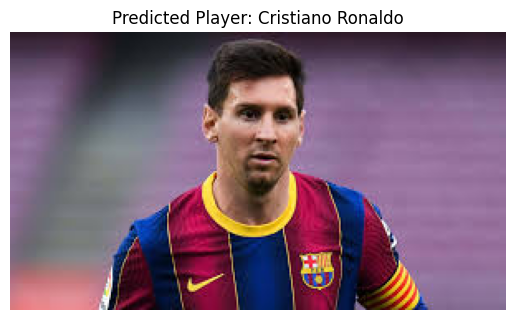

Image: images (14).jpg, Predicted Player: None
1/1 [==============================] - 0s 35ms/step


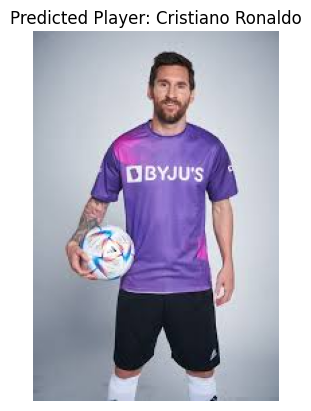

Image: images (15).jpg, Predicted Player: None
1/1 [==============================] - 0s 44ms/step


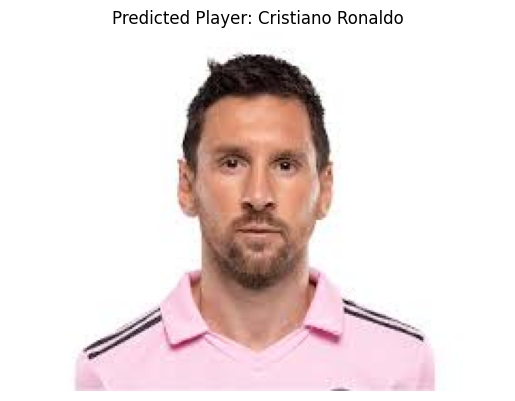

Image: images (16).jpg, Predicted Player: None
1/1 [==============================] - 0s 34ms/step


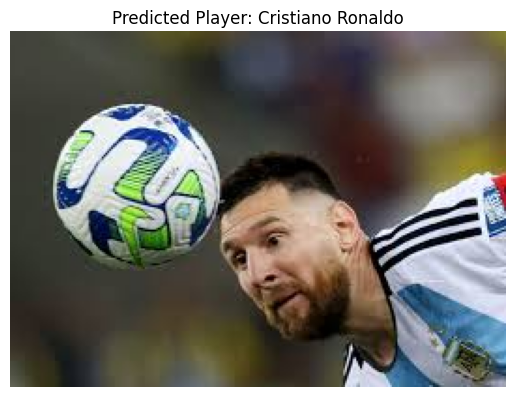

Image: images (17).jpg, Predicted Player: None
1/1 [==============================] - 0s 39ms/step


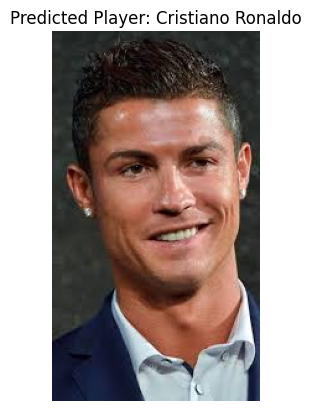

Image: images (18).jpg, Predicted Player: None
1/1 [==============================] - 0s 43ms/step


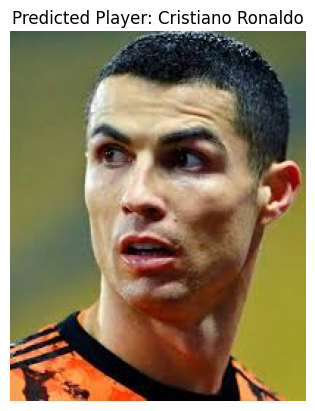

Image: images (19).jpg, Predicted Player: None
1/1 [==============================] - 0s 28ms/step


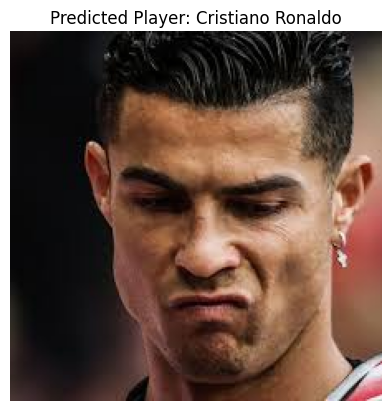

Image: images (2).jpg, Predicted Player: None
1/1 [==============================] - 0s 36ms/step


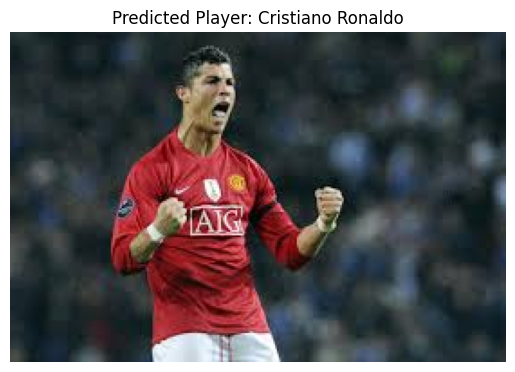

Image: images (3).jpg, Predicted Player: None
1/1 [==============================] - 0s 26ms/step


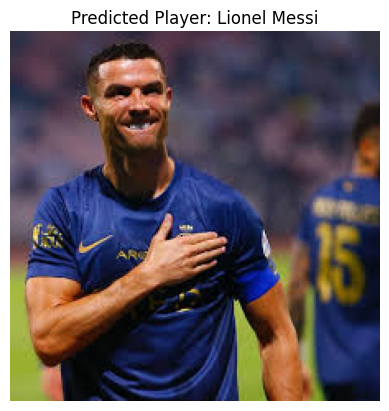

Image: images (4).jpg, Predicted Player: None
1/1 [==============================] - 0s 30ms/step


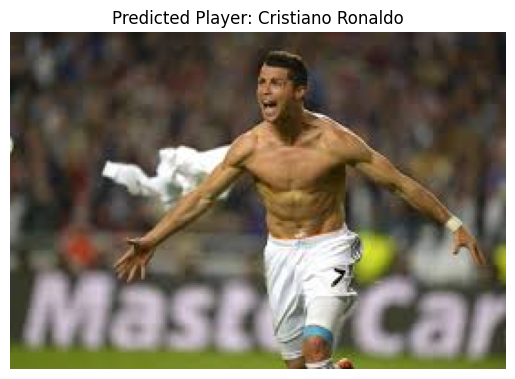

Image: images (5).jpg, Predicted Player: None
1/1 [==============================] - 0s 27ms/step


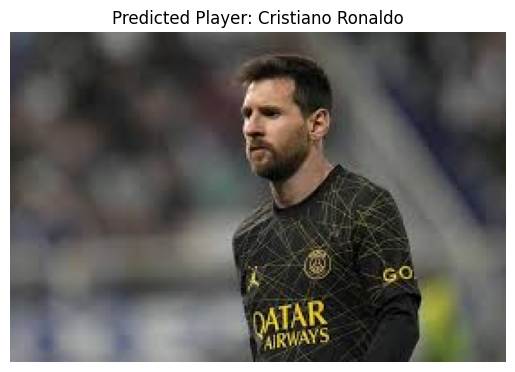

Image: images (6).jpg, Predicted Player: None
1/1 [==============================] - 0s 30ms/step


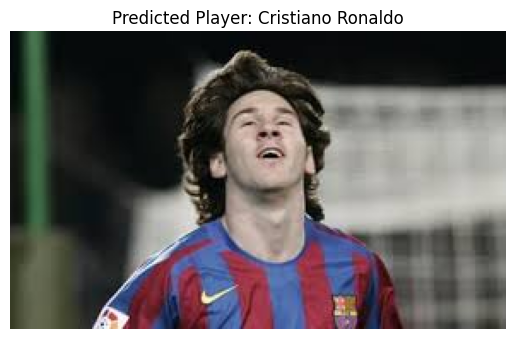

Image: images (7).jpg, Predicted Player: None
1/1 [==============================] - 0s 26ms/step


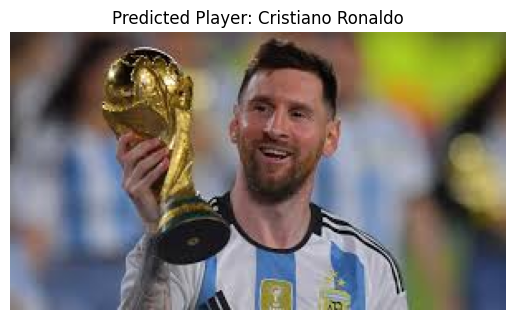

Image: images (8).jpg, Predicted Player: None
1/1 [==============================] - 0s 30ms/step


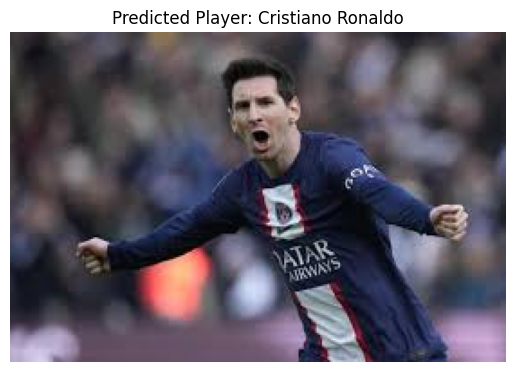

Image: images (9).jpg, Predicted Player: None
1/1 [==============================] - 0s 29ms/step


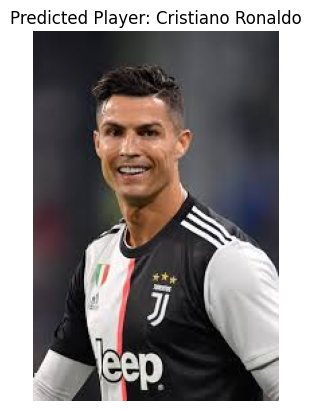

Image: images.jpg, Predicted Player: None


In [226]:
# Loop through all test images in the folder
for image_name in os.listdir(test_images_folder):
    image_path = os.path.join(test_images_folder, image_name)
    
    # Predict and display the image for each image
    predicted_label = predict_and_display_image(image_path, best_model, label_encoder)
    
    # Print the predicted player's name for each image
    print(f'Image: {image_name}, Predicted Player: {predicted_label}')

In [13]:
Final_Observation = print("""The model demonstrates moderate effectiveness in making predictions, performing well within the constraints of the dataset provided, evidenced by its high accuracy in controlled conditions. However, for deployment in real-world scenarios, there's substantial room for improvement to meet practical application standards. A promising direction for enhancing the model's robustness and applicability in diverse environments involves the integration of facial bounding box detection techniques. This approach can significantly refine the accuracy of future classifications by focusing on the most relevant features of the images, thereby bolstering the model's utility in real-world applications.""")

The model demonstrates moderate effectiveness in making predictions, performing well within the constraints of the dataset provided, evidenced by its high accuracy in controlled conditions. However, for deployment in real-world scenarios, there's substantial room for improvement to meet practical application standards. A promising direction for enhancing the model's robustness and applicability in diverse environments involves the integration of facial bounding box detection techniques. This approach can significantly refine the accuracy of future classifications by focusing on the most relevant features of the images, thereby bolstering the model's utility in real-world applications.
